In [1]:
import numpy as np
import os
import matplotlib.pyplot as plt
import math
from numpy import nanmean
import pandas as pd
from scipy import stats
import matplotlib.ticker as tk
import cooltools.lib.plotting
%matplotlib notebook
import warnings
warnings.filterwarnings('ignore')
import pyBigWig
import cooler
def format_ticks(ax, x=True, y=True, rotate=True):
    if y:
        ax.yaxis.set_major_formatter(bp_formatter)
    if x:
        ax.xaxis.set_major_formatter(bp_formatter)
        ax.xaxis.tick_bottom()
    if rotate:
        ax.tick_params(axis='x',rotation=45)
        
        
from cooltools.lib.numutils import adaptive_coarsegrain, interp_nan
from matplotlib.colors import LogNorm
import cooltools.lib.plotting

# to plot ticks in terms of megabases we use the EngFormatter
# https://matplotlib.org/gallery/api/engineering_formatter.html
from matplotlib.ticker import EngFormatter
bp_formatter = EngFormatter('b')
import pandas as pd
from scipy.signal import find_peaks
# import libraries for biological data analysis
from coolpuppy import coolpup
from coolpuppy.lib import numutils
from coolpuppy.lib.puputils import divide_pups
from coolpuppy import plotpup
import cooler
import bioframe
import cooltools
from cooltools import expected_cis, expected_trans
from cooltools.lib import plotting


/home/admindario/miniconda3/lib/python3.9/site-packages/cooltools/lib/numutils.py:11: FutureWarning: The `cooler.tools` module is deprecated in v0.9 and will be removed in v0.10. Use `cooler.parallel` instead.
  from ._numutils import (
/home/admindario/miniconda3/lib/python3.9/site-packages/cooltools/lib/numutils.py:652: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def iterative_correction_symmetric(
/home/admindario/miniconda3/lib/python3.9/site-packages/cooltools/lib/numutils.py:727: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be chang

## Origins analysis 

In [3]:
#Load IPLS signal, one copy can be found in LatticePoly/LatticePoly/
dir_IPLS="/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/JM_data_yeast/"
sim =  pd.read_csv(dir_IPLS+"/global_profiles.csv")
all_origins=sim
#Extract peaks (corresponding to origins)
peaks=find_peaks(all_origins["signal"],distance=int(5))
mask=np.zeros(len(sim["signal"]))
mask[peaks[0]] = 1
all_origins["is_origin"]=mask
#Build a dataframe with all the origins, load MicroC data for correct chromsome names (roman numbers)
dir_coolers="/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"
clr = cooler.Cooler(dir_coolers+'/GSM4585143_23C-15min.mcool::/resolutions/200')
view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})

index=np.arange(0,17)
for i in range(len(all_origins["chrom"])):
    for ind in index:
        if(int(all_origins["chrom"].iloc[i][3:])==ind+1):
            all_origins["chrom"].iloc[i]=view_df["chrom"].iloc[ind]
            break
all_origins=all_origins.rename(columns={"chromStart":"start","chromEnd":"end"})

            
all_origins=all_origins.drop(all_origins[all_origins["is_origin"][:]==False].index)
all_origins=all_origins.drop(all_origins[all_origins["signal"][:]<0].index)

all_origins["mid"]=all_origins["end"]
all_origins["start"]=all_origins["start"]
all_origins["end"]=all_origins["end"]
all_origins["name"]="origin"
#all_origins=all_origins.reset_index(drop=True)

chrom=[]
start=[]
end=[]
signal=[]
mid=[]
dist_cen=[]
dist_tel=[]


centromeres=[151,239,114,450,152,149,497,106,356,436,440,151,268,629,327,556]

for i in range(0,len(all_origins["chrom"])):
    chrom.append(all_origins["chrom"].iloc[i])
    start.append(all_origins["start"].iloc[i])
    end.append(all_origins["end"].iloc[i])
    signal.append(all_origins["signal"].iloc[i])
    mid.append(all_origins["mid"].iloc[i])
    for j in range(len(centromeres)):
        if(all_origins["chrom"].iloc[i]==clr.chromnames[j]):
            dist_cen.append(abs(centromeres[j]*1000-all_origins["mid"].iloc[i]))
            if((view_df[view_df["chrom"]==clr.chromnames[j]]["end"]-all_origins["mid"].iloc[i]).iloc[0] > all_origins["mid"].iloc[i]):
                dist_tel.append(all_origins["mid"].iloc[i])
            else:
                dist_tel.append((view_df[view_df["chrom"]==clr.chromnames[j]]["end"]).iloc[0]-all_origins["mid"].iloc[i])
                
                

            


#Dataframe to use in the aggregate
all_sites=pd.DataFrame({"chrom":chrom,"start":start,"end":end,"mid":mid,"dist_cen":dist_cen,"dist_tel":dist_tel,"signal":signal})  

#Create a copy with the names compatible with HiC maps in HU arrested condition

chrom_hu=[]
for i in range(len(all_sites)):
    dir_coolers_hu="/home/admindario/Downloads"
    clrHIC = cooler.Cooler(dir_coolers_hu+"/GSM4946280_KJ22_scc2.cool")
    clrMicro= cooler.Cooler(dir_coolers+'/GSM4585143_23C-15min.mcool::/resolutions/200')
    for j in range(len(clrMicro.chromnames)):
        if(all_sites["chrom"][i]==clrMicro.chromnames[j]):
            chrom_hu.append(clrHIC.chromnames[j])
            
all_sites_hu=pd.DataFrame({"chrom":chrom_hu,"start":start,"end":end,"mid":mid,"dist_cen":dist_cen,"dist_tel":dist_tel,"signal":signal})

<IPython.core.display.Javascript object>


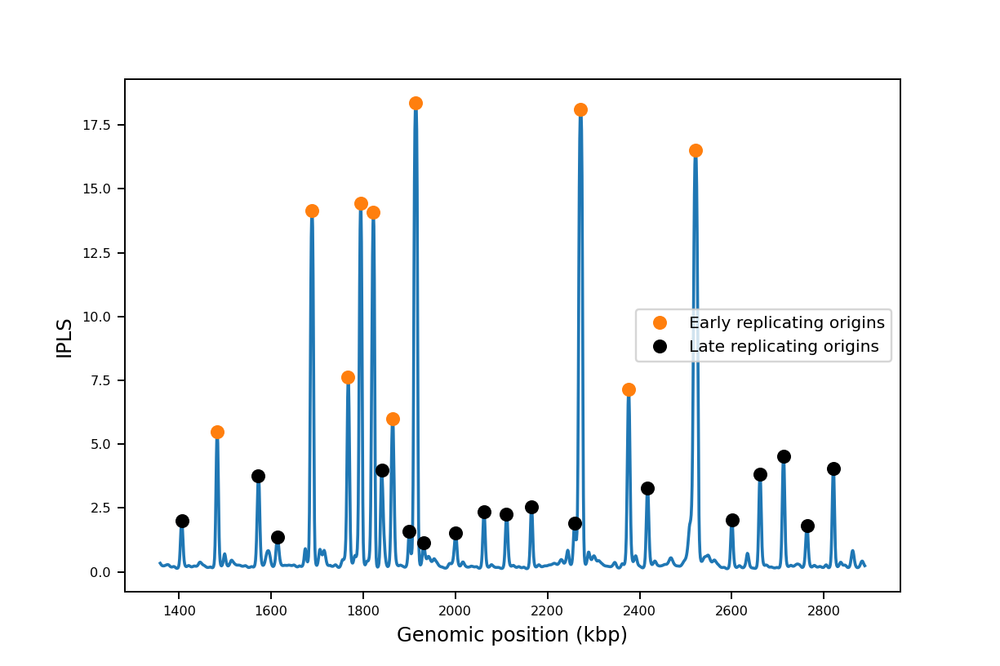

In [7]:

#%matplotlib notebook
resize=3
f, (ax_plot) = plt.subplots(1, 1, figsize=(12/resize, 8/resize))

ax_plot.plot(sim[sim["chrom"]=="chrIV"]["signal"])
ax_plot.plot(all_origins[(all_origins["chrom"]=="chrIV")*(all_origins["signal"]>5)]["signal"],"o",label="Early replicating origins")    
ax_plot.plot(all_origins[(all_origins["chrom"]=="chrIV")*(all_origins["signal"]>1)*(all_origins["signal"]<5)]["signal"],"ko",label="Late replicating origins")
ax_plot.set_xlabel('Genomic position (kbp)', fontsize=30/resize)
ax_plot.set_ylabel('IPLS',size=30/resize)
ax_plot.legend( prop={'size': 25/resize},loc="center right")
ax_plot.xaxis.set_tick_params(labelsize=20/resize)
ax_plot.yaxis.set_tick_params(labelsize=20/resize)


# Experimental Data
## Signal around top 15% origins - HU arrested 

<IPython.core.display.Javascript object>


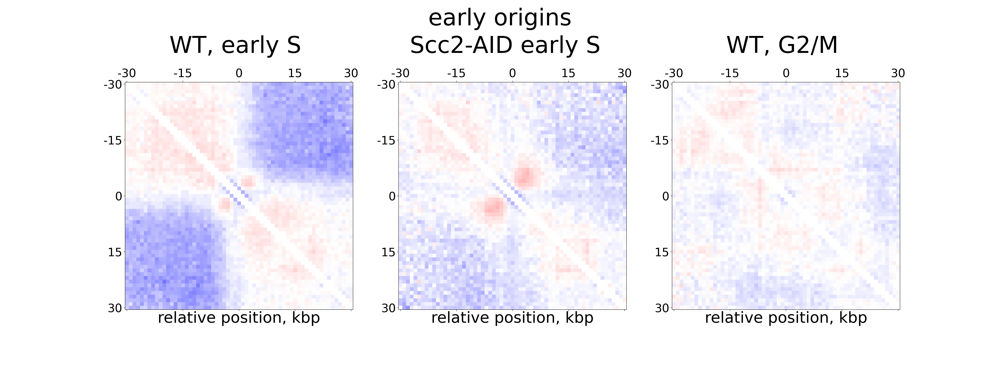

INFO:coolpuppy:('I', 'I'): 2
INFO:coolpuppy:('II', 'II'): 8
INFO:coolpuppy:('III', 'III'): 4
INFO:coolpuppy:('IV', 'IV'): 10
INFO:coolpuppy:('V', 'V'): 5
INFO:coolpuppy:('VI', 'VI'): 4
INFO:coolpuppy:('VII', 'VII'): 12
INFO:coolpuppy:('VIII', 'VIII'): 5
INFO:coolpuppy:('IX', 'IX'): 3
INFO:coolpuppy:('X', 'X'): 7
INFO:coolpuppy:('XI', 'XI'): 8
INFO:coolpuppy:('XII', 'XII'): 10
INFO:coolpuppy:('XIII', 'XIII'): 9
INFO:coolpuppy:('XIV', 'XIV'): 6
INFO:coolpuppy:('XV', 'XV'): 9
INFO:coolpuppy:('XVI', 'XVI'): 7
INFO:coolpuppy:Total number of piled up windows: 109
INFO:coolpuppy:('I', 'I'): 2
INFO:coolpuppy:('II', 'II'): 8
INFO:coolpuppy:('III', 'III'): 4
INFO:coolpuppy:('IV', 'IV'): 10
INFO:coolpuppy:('V', 'V'): 5
INFO:coolpuppy:('VI', 'VI'): 4
INFO:coolpuppy:('VII', 'VII'): 12
INFO:coolpuppy:('VIII', 'VIII'): 5
INFO:coolpuppy:('IX', 'IX'): 3
INFO:coolpuppy:('X', 'X'): 7
INFO:coolpuppy:('XI', 'XI'): 8
INFO:coolpuppy:('XII', 'XII'): 10
INFO:coolpuppy:('XIII', 'XIII'): 9
INFO:coolpuppy:('XIV',

<IPython.core.display.Javascript object>


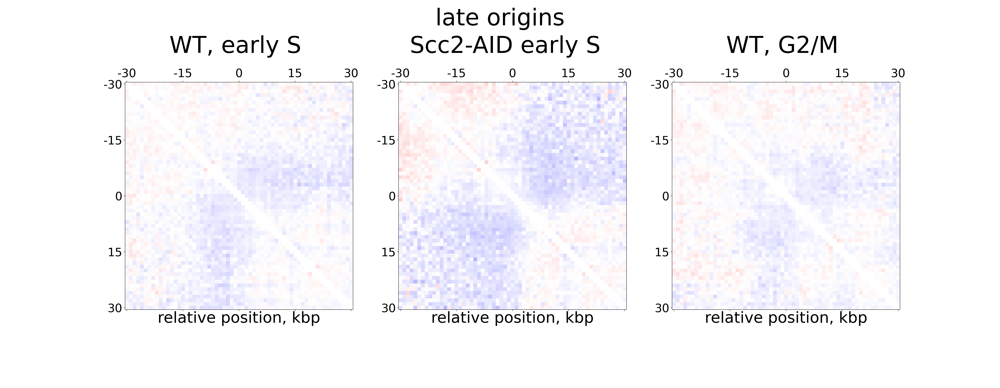

INFO:coolpuppy:('I', 'I'): 2
INFO:coolpuppy:('II', 'II'): 2
INFO:coolpuppy:('III', 'III'): 2
INFO:coolpuppy:('IV', 'IV'): 17
INFO:coolpuppy:('V', 'V'): 7
INFO:coolpuppy:('VII', 'VII'): 8
INFO:coolpuppy:('VIII', 'VIII'): 5
INFO:coolpuppy:('IX', 'IX'): 7
INFO:coolpuppy:('X', 'X'): 7
INFO:coolpuppy:('XI', 'XI'): 5
INFO:coolpuppy:('XII', 'XII'): 10
INFO:coolpuppy:('XIII', 'XIII'): 7
INFO:coolpuppy:('XIV', 'XIV'): 10
INFO:coolpuppy:('XV', 'XV'): 13
INFO:coolpuppy:('XVI', 'XVI'): 13
INFO:coolpuppy:Total number of piled up windows: 115
INFO:coolpuppy:('I', 'I'): 2
INFO:coolpuppy:('II', 'II'): 2
INFO:coolpuppy:('III', 'III'): 2
INFO:coolpuppy:('IV', 'IV'): 17
INFO:coolpuppy:('V', 'V'): 7
INFO:coolpuppy:('VII', 'VII'): 8
INFO:coolpuppy:('VIII', 'VIII'): 5
INFO:coolpuppy:('IX', 'IX'): 7
INFO:coolpuppy:('X', 'X'): 7
INFO:coolpuppy:('XI', 'XI'): 5
INFO:coolpuppy:('XII', 'XII'): 10
INFO:coolpuppy:('XIII', 'XIII'): 7
INFO:coolpuppy:('XIV', 'XIV'): 10
INFO:coolpuppy:('XV', 'XV'): 13
INFO:coolpuppy:('

In [5]:
HiC_mtx=[]
HiC_expected=[]
labels=["WT, early S","Scc2-AID early S ","WT, G2/M"]
titles=["early origins","late origins"]
dfs=[all_sites_hu[(all_sites_hu["signal"]>5)],all_sites_hu[(all_sites_hu["signal"]>1)*(all_sites_hu["signal"]<5)]]
for e in range(len(dfs)):
    n_groups=len(labels)
    fig, axs = plt.subplots(1, n_groups, figsize=(12*n_groups, 14))
    fig.suptitle(titles[e],size=60)
    directory=["GSM4946279_KJ20_WT.cool","GSM4946280_KJ22_scc2.cool","GSM4946266_KJ1_G2.cool"]
    for dire in range(0,len(directory)):
        resolution=1000
        flank=30_000
        sites_frame=dfs[e]

        clr = cooler.Cooler(dir_coolers_hu+"/"+directory[dire])
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        ax = axs[dire]
        im=ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)


## Signal around top 15% origins - MicroC

<IPython.core.display.Javascript object>


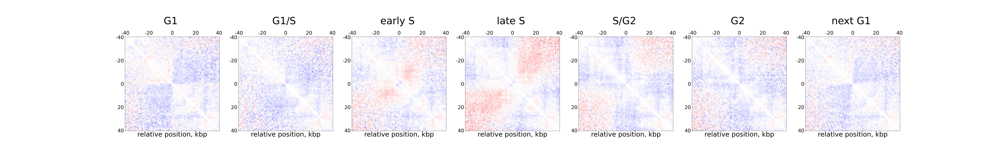

INFO:coolpuppy:('chrI', 'chrI'): 2
INFO:coolpuppy:('chrII', 'chrII'): 8
INFO:coolpuppy:('chrIII', 'chrIII'): 4
INFO:coolpuppy:('chrIV', 'chrIV'): 10
INFO:coolpuppy:('chrV', 'chrV'): 5
INFO:coolpuppy:('chrVI', 'chrVI'): 4
INFO:coolpuppy:('chrVII', 'chrVII'): 12
INFO:coolpuppy:('chrVIII', 'chrVIII'): 5
INFO:coolpuppy:('chrIX', 'chrIX'): 3
INFO:coolpuppy:('chrX', 'chrX'): 7
INFO:coolpuppy:('chrXI', 'chrXI'): 8
INFO:coolpuppy:('chrXII', 'chrXII'): 10
INFO:coolpuppy:('chrXIII', 'chrXIII'): 8
INFO:coolpuppy:('chrXIV', 'chrXIV'): 6
INFO:coolpuppy:('chrXV', 'chrXV'): 8
INFO:coolpuppy:('chrXVI', 'chrXVI'): 7
INFO:coolpuppy:Total number of piled up windows: 107
INFO:coolpuppy:('chrI', 'chrI'): 2
INFO:coolpuppy:('chrII', 'chrII'): 8
INFO:coolpuppy:('chrIII', 'chrIII'): 4
INFO:coolpuppy:('chrIV', 'chrIV'): 10
INFO:coolpuppy:('chrV', 'chrV'): 5
INFO:coolpuppy:('chrVI', 'chrVI'): 4
INFO:coolpuppy:('chrVII', 'chrVII'): 12
INFO:coolpuppy:('chrVIII', 'chrVIII'): 5
INFO:coolpuppy:('chrIX', 'chrIX'): 3
I

<IPython.core.display.Javascript object>


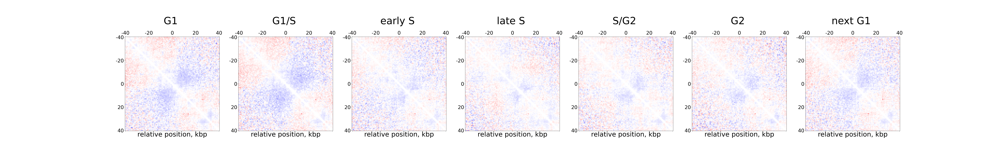

INFO:coolpuppy:('chrI', 'chrI'): 2
INFO:coolpuppy:('chrII', 'chrII'): 2
INFO:coolpuppy:('chrIII', 'chrIII'): 2
INFO:coolpuppy:('chrIV', 'chrIV'): 17
INFO:coolpuppy:('chrV', 'chrV'): 7
INFO:coolpuppy:('chrVII', 'chrVII'): 8
INFO:coolpuppy:('chrVIII', 'chrVIII'): 5
INFO:coolpuppy:('chrIX', 'chrIX'): 7
INFO:coolpuppy:('chrX', 'chrX'): 7
INFO:coolpuppy:('chrXI', 'chrXI'): 5
INFO:coolpuppy:('chrXII', 'chrXII'): 10
INFO:coolpuppy:('chrXIII', 'chrXIII'): 7
INFO:coolpuppy:('chrXIV', 'chrXIV'): 10
INFO:coolpuppy:('chrXV', 'chrXV'): 12
INFO:coolpuppy:('chrXVI', 'chrXVI'): 13
INFO:coolpuppy:Total number of piled up windows: 114
INFO:coolpuppy:('chrI', 'chrI'): 2
INFO:coolpuppy:('chrII', 'chrII'): 2
INFO:coolpuppy:('chrIII', 'chrIII'): 2
INFO:coolpuppy:('chrIV', 'chrIV'): 17
INFO:coolpuppy:('chrV', 'chrV'): 7
INFO:coolpuppy:('chrVII', 'chrVII'): 8
INFO:coolpuppy:('chrVIII', 'chrVIII'): 5
INFO:coolpuppy:('chrIX', 'chrIX'): 7
INFO:coolpuppy:('chrX', 'chrX'): 7
INFO:coolpuppy:('chrXI', 'chrXI'): 5
IN

In [7]:
labels=["G1","G1/S","early S","late S","S/G2","G2","next G1"]
titles=["early origins","late origins"]

dfs=[all_sites[(all_sites["signal"]>5)],all_sites[(all_sites["signal"]<5)*(all_sites["signal"]>1)]]
#dfs=[all_cars[all_cars["value"]>50]]
exp_mtx=[]
for e in range(len(dfs)):
    expected_MicroC=[]

    n_groups=len(labels)
    fig, axs = plt.subplots(1, n_groups, figsize=(12*n_groups, 14))
    directory=["GSM4585143_23C-15min.mcool","GSM4585144_23C-30min.mcool","GSM4585145_23C-45min.mcool","GSM4585146_23C-60min.mcool","GSM4585147_23C-75min.mcool","GSM4585148_23C-90min.mcool","GSM4585149_23C-105min.mcool"]
    for dire in range(len(directory)):
        resolution=800
        flank=40_000
       
       
        #sites_frame=dfs[e][(dfs[e]["dist_tel"]>flank)*(dfs[e]["start"]>flank)]
        sites_frame=dfs[e]
        
        clr = cooler.Cooler(dir_coolers+"/"+directory[dire]+"::/resolutions/"+str(resolution))
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        expected['s_bp'] = expected['dist']* resolution
        expected['count.sum'].loc[expected['dist'] < 2] = np.nan
        region="chrIV"
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        ax = axs[dire]
        ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)

## Signal around origins- distance from centromere >40 kb 

<IPython.core.display.Javascript object>


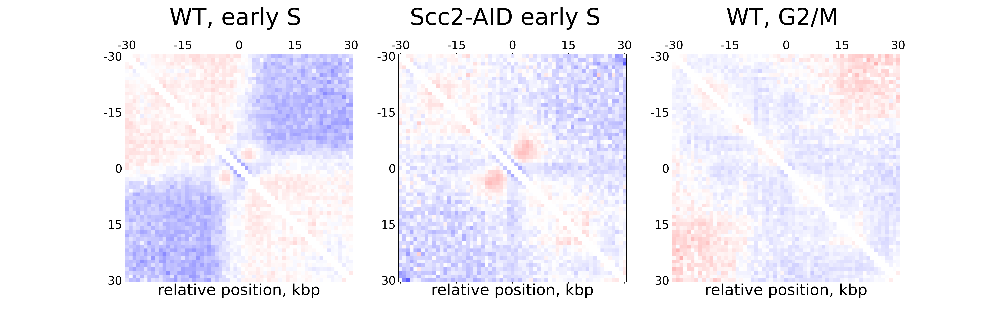

INFO:coolpuppy:('II', 'II'): 4
INFO:coolpuppy:('III', 'III'): 2
INFO:coolpuppy:('IV', 'IV'): 8
INFO:coolpuppy:('V', 'V'): 3
INFO:coolpuppy:('VI', 'VI'): 1
INFO:coolpuppy:('VII', 'VII'): 10
INFO:coolpuppy:('VIII', 'VIII'): 3
INFO:coolpuppy:('IX', 'IX'): 1
INFO:coolpuppy:('X', 'X'): 5
INFO:coolpuppy:('XI', 'XI'): 6
INFO:coolpuppy:('XII', 'XII'): 9
INFO:coolpuppy:('XIII', 'XIII'): 7
INFO:coolpuppy:('XIV', 'XIV'): 4
INFO:coolpuppy:('XV', 'XV'): 8
INFO:coolpuppy:('XVI', 'XVI'): 6
INFO:coolpuppy:Total number of piled up windows: 77
INFO:coolpuppy:('II', 'II'): 4
INFO:coolpuppy:('III', 'III'): 2
INFO:coolpuppy:('IV', 'IV'): 8
INFO:coolpuppy:('V', 'V'): 3
INFO:coolpuppy:('VI', 'VI'): 1
INFO:coolpuppy:('VII', 'VII'): 10
INFO:coolpuppy:('VIII', 'VIII'): 3
INFO:coolpuppy:('IX', 'IX'): 1
INFO:coolpuppy:('X', 'X'): 5
INFO:coolpuppy:('XI', 'XI'): 6
INFO:coolpuppy:('XII', 'XII'): 9
INFO:coolpuppy:('XIII', 'XIII'): 7
INFO:coolpuppy:('XIV', 'XIV'): 4
INFO:coolpuppy:('XV', 'XV'): 8
INFO:coolpuppy:('XVI'

In [8]:
HiC_mtx=[]
HiC_expected=[]
labels=["WT, early S","Scc2-AID early S ","WT, G2/M"]
dfs=[all_sites_hu[(all_sites_hu["signal"]>5)*(all_sites_hu["dist_cen"]>40_000)]]
for e in range(len(dfs)):
    n_groups=len(labels)
    fig, axs = plt.subplots(1, n_groups, figsize=(12*n_groups, 12))
    #fig.suptitle(titles[e],size=40)
    directory=["GSM4946279_KJ20_WT.cool","GSM4946280_KJ22_scc2.cool","GSM4946266_KJ1_G2.cool"]
    for dire in range(0,len(directory)):
        resolution=1000
        flank=30_000
        sites_frame=dfs[e]

        clr = cooler.Cooler(dir_coolers_hu+"/"+directory[dire])
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        ax = axs[dire]
        im=ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)


<IPython.core.display.Javascript object>


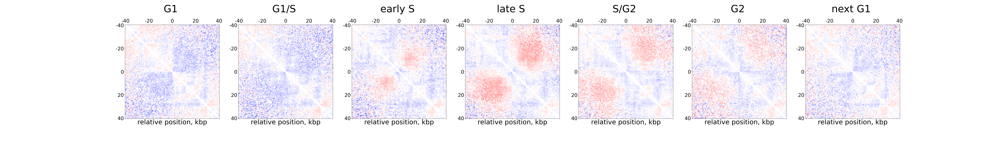

INFO:coolpuppy:('chrII', 'chrII'): 4
INFO:coolpuppy:('chrIII', 'chrIII'): 2
INFO:coolpuppy:('chrIV', 'chrIV'): 8
INFO:coolpuppy:('chrV', 'chrV'): 3
INFO:coolpuppy:('chrVI', 'chrVI'): 1
INFO:coolpuppy:('chrVII', 'chrVII'): 10
INFO:coolpuppy:('chrVIII', 'chrVIII'): 3
INFO:coolpuppy:('chrIX', 'chrIX'): 1
INFO:coolpuppy:('chrX', 'chrX'): 5
INFO:coolpuppy:('chrXI', 'chrXI'): 6
INFO:coolpuppy:('chrXII', 'chrXII'): 9
INFO:coolpuppy:('chrXIII', 'chrXIII'): 6
INFO:coolpuppy:('chrXIV', 'chrXIV'): 4
INFO:coolpuppy:('chrXV', 'chrXV'): 7
INFO:coolpuppy:('chrXVI', 'chrXVI'): 6
INFO:coolpuppy:Total number of piled up windows: 75
INFO:coolpuppy:('chrII', 'chrII'): 4
INFO:coolpuppy:('chrIII', 'chrIII'): 2
INFO:coolpuppy:('chrIV', 'chrIV'): 8
INFO:coolpuppy:('chrV', 'chrV'): 3
INFO:coolpuppy:('chrVI', 'chrVI'): 1
INFO:coolpuppy:('chrVII', 'chrVII'): 10
INFO:coolpuppy:('chrVIII', 'chrVIII'): 3
INFO:coolpuppy:('chrIX', 'chrIX'): 1
INFO:coolpuppy:('chrX', 'chrX'): 5
INFO:coolpuppy:('chrXI', 'chrXI'): 6
INF

In [9]:
labels=["G1","G1/S","early S","late S","S/G2","G2","next G1"]

dfs=[all_sites[(all_sites["signal"]>5)]]

exp_mtx=[]
for e in range(len(dfs)):
    expected_MicroC=[]

    n_groups=len(labels)
    fig, axs = plt.subplots(1, n_groups, figsize=(12*n_groups, 12))
    directory=["GSM4585143_23C-15min.mcool","GSM4585144_23C-30min.mcool","GSM4585145_23C-45min.mcool","GSM4585146_23C-60min.mcool","GSM4585147_23C-75min.mcool","GSM4585148_23C-90min.mcool","GSM4585149_23C-105min.mcool"]
    for dire in range(len(directory)):
        resolution=800
        flank=40_000
       
       
        sites_frame=dfs[e][(dfs[e]["dist_cen"]>flank)]
        
        clr = cooler.Cooler(dir_coolers+"/"+directory[dire]+"::/resolutions/"+str(resolution))
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        expected['s_bp'] = expected['dist']* resolution
        expected['count.sum'].loc[expected['dist'] < 2] = np.nan
        region="chrIV"
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        ax = axs[dire]
        ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)

## Signal around CARs

In [8]:
import bioframe
chrom_dfs=[]
for chrom in clr.chromnames[:-1]:
    #load ChIP-seq (M-arrested)
    df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/GSE151416_RAW"+"/GSM4577764_Mcd1p_WT.bigwig", chrom)
    df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
    a1=[]
    #rebin at 1kb
    for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
        a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))

    peaks=find_peaks(a1,height=20,distance=int(1))
    df=pd.DataFrame(1000*np.array([list(peaks[0]),list(peaks[0])]).T,columns=["start","end"])
    df["chrom"]=chrom
    df["signal"]=peaks[1]["peak_heights"]
    chrom_dfs.append(df)

    
CARs_exp=pd.concat(chrom_dfs)

<IPython.core.display.Javascript object>


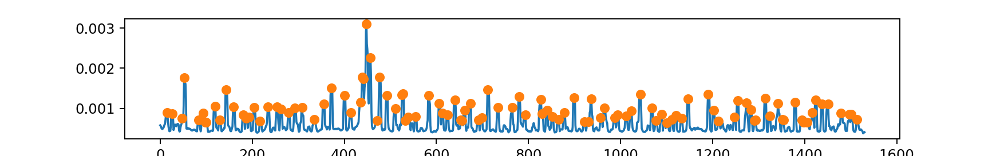

In [9]:
def smooth_array(ser, sc):
    return np.array(pd.Series(ser).rolling(sc, min_periods=1, center=True).mean())

#Example CARs of chrIV
chrom="chrIV"
df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/GSE151416_RAW"+"/GSM4577764_Mcd1p_WT.bigwig", chrom)

df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
a1=[]
for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
    a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
a1=smooth_array(a1,5)
peaks=find_peaks(a1,height=20,distance=int(1))
plt.figure()
plt.plot(a1/np.sum(a1))
plt.plot(peaks[0],peaks[1]["peak_heights"]/np.sum(a1),"o")



In [13]:
cen_dist=[]
tel_dist=[]
for k,chrom in enumerate(clr.chromnames[:-1]):
    cen_dist.extend(np.abs(CARs_exp[CARs_exp["chrom"]==chrom]["start"]-1000*centromeres[k]))
    tel_dist.extend(np.abs(CARs_exp[CARs_exp["chrom"]==chrom]["start"]-clr.chromsizes[k]))
CARs_exp["cen_dist"]=cen_dist
CARs_exp["tel_dist"]=tel_dist

In [20]:
#Define early CARs
early_replicated=[]

for i in range(len(CARs_exp)):
    chrom=CARs_exp.iloc[i]["chrom"]
    start_CAR=CARs_exp.iloc[i]["start"]
    if((np.abs(all_sites[all_sites["signal"]>5][all_sites[all_sites["signal"]>5]["chrom"]==chrom]["start"]-start_CAR)<40_000).any()==True):
        early_replicated.append(1)
    elif((np.abs(all_sites[all_sites["signal"]>5][all_sites[all_sites["signal"]>5]["chrom"]==chrom]["start"]-start_CAR)>100_000).all()==True):
        early_replicated.append(-1)
    else:
        early_replicated.append(0)
CARs_exp["early_replicated"]=early_replicated
early_CAR=CARs_exp[CARs_exp["early_replicated"]==1]
top_CARs_exp=CARs_exp.sort_values("signal",ascending=False)[:len(all_sites[all_sites["signal"]>5])]

## Signal around early replicatin CARs (40 kb distance with top 15% origins)

<IPython.core.display.Javascript object>


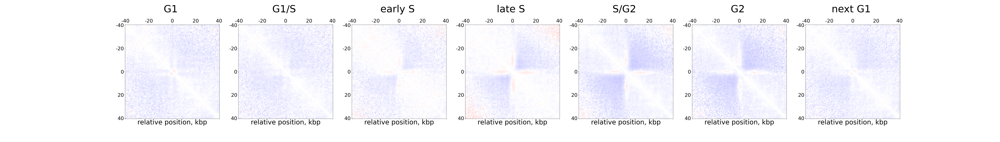

INFO:coolpuppy:('chrI', 'chrI'): 14
INFO:coolpuppy:('chrII', 'chrII'): 46
INFO:coolpuppy:('chrIII', 'chrIII'): 25
INFO:coolpuppy:('chrIV', 'chrIV'): 64
INFO:coolpuppy:('chrV', 'chrV'): 27
INFO:coolpuppy:('chrVI', 'chrVI'): 19
INFO:coolpuppy:('chrVII', 'chrVII'): 78
INFO:coolpuppy:('chrVIII', 'chrVIII'): 37
INFO:coolpuppy:('chrIX', 'chrIX'): 26
INFO:coolpuppy:('chrX', 'chrX'): 42
INFO:coolpuppy:('chrXI', 'chrXI'): 51
INFO:coolpuppy:('chrXII', 'chrXII'): 84
INFO:coolpuppy:('chrXIII', 'chrXIII'): 58
INFO:coolpuppy:('chrXIV', 'chrXIV'): 43
INFO:coolpuppy:('chrXV', 'chrXV'): 66
INFO:coolpuppy:('chrXVI', 'chrXVI'): 53
INFO:coolpuppy:Total number of piled up windows: 733
INFO:coolpuppy:('chrI', 'chrI'): 14
INFO:coolpuppy:('chrII', 'chrII'): 46
INFO:coolpuppy:('chrIII', 'chrIII'): 25
INFO:coolpuppy:('chrIV', 'chrIV'): 64
INFO:coolpuppy:('chrV', 'chrV'): 27
INFO:coolpuppy:('chrVI', 'chrVI'): 19
INFO:coolpuppy:('chrVII', 'chrVII'): 78
INFO:coolpuppy:('chrVIII', 'chrVIII'): 37
INFO:coolpuppy:('ch

In [244]:
labels=["G1","G1/S","early S","late S","S/G2","G2","next G1"]

#Plot all early CARs
dfs=[CARs_exp[CARs_exp["early_replicated"]==1]]
exp_mtx=[]
for e in range(0,len(dfs)):
    expected_MicroC=[]

    n_groups=len(labels)
    fig, axs = plt.subplots(1, n_groups, figsize=(12*n_groups, 12))
    directory=["GSM4585143_23C-15min.mcool","GSM4585144_23C-30min.mcool","GSM4585145_23C-45min.mcool","GSM4585146_23C-60min.mcool","GSM4585147_23C-75min.mcool","GSM4585148_23C-90min.mcool","GSM4585149_23C-105min.mcool"]
    for dire in range(len(directory)):
        resolution=800
        flank=40_000
        sites_frame=dfs[e]

        clr = cooler.Cooler(dir_coolers+"/"+directory[dire]+"::/resolutions/"+str(resolution))
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        expected['s_bp'] = expected['dist']* resolution
        expected['count.sum'].loc[expected['dist'] < 2] = np.nan
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        ax = axs[dire]
        ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)

<IPython.core.display.Javascript object>


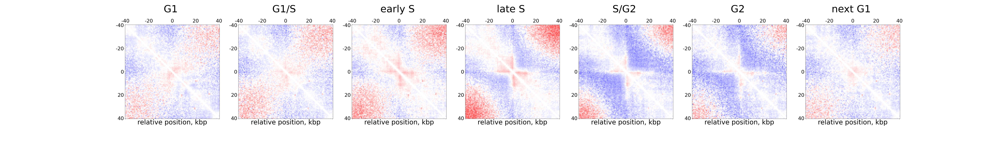

INFO:coolpuppy:('chrI', 'chrI'): 3
INFO:coolpuppy:('chrII', 'chrII'): 8
INFO:coolpuppy:('chrIII', 'chrIII'): 4
INFO:coolpuppy:('chrIV', 'chrIV'): 12
INFO:coolpuppy:('chrV', 'chrV'): 8
INFO:coolpuppy:('chrVI', 'chrVI'): 6
INFO:coolpuppy:('chrVII', 'chrVII'): 9
INFO:coolpuppy:('chrVIII', 'chrVIII'): 5
INFO:coolpuppy:('chrIX', 'chrIX'): 4
INFO:coolpuppy:('chrX', 'chrX'): 7
INFO:coolpuppy:('chrXI', 'chrXI'): 11
INFO:coolpuppy:('chrXII', 'chrXII'): 7
INFO:coolpuppy:('chrXIII', 'chrXIII'): 6
INFO:coolpuppy:('chrXIV', 'chrXIV'): 5
INFO:coolpuppy:('chrXV', 'chrXV'): 6
INFO:coolpuppy:('chrXVI', 'chrXVI'): 6
INFO:coolpuppy:Total number of piled up windows: 107
INFO:coolpuppy:('chrI', 'chrI'): 3
INFO:coolpuppy:('chrII', 'chrII'): 8
INFO:coolpuppy:('chrIII', 'chrIII'): 4
INFO:coolpuppy:('chrIV', 'chrIV'): 12
INFO:coolpuppy:('chrV', 'chrV'): 8
INFO:coolpuppy:('chrVI', 'chrVI'): 6
INFO:coolpuppy:('chrVII', 'chrVII'): 9
INFO:coolpuppy:('chrVIII', 'chrVIII'): 5
INFO:coolpuppy:('chrIX', 'chrIX'): 4
INF

In [81]:
labels=["G1","G1/S","early S","late S","S/G2","G2","next G1"]

#Plot strongest early CARS (same statistic as early origins-107 sites)
dfs=[early_CAR]
exp_mtx=[]
for e in range(0,len(dfs)):
    expected_MicroC=[]

    n_groups=len(labels)
    fig, axs = plt.subplots(1, n_groups, figsize=(12*n_groups, 12))
    directory=["GSM4585143_23C-15min.mcool","GSM4585144_23C-30min.mcool","GSM4585145_23C-45min.mcool","GSM4585146_23C-60min.mcool","GSM4585147_23C-75min.mcool","GSM4585148_23C-90min.mcool","GSM4585149_23C-105min.mcool"]
    for dire in range(len(directory)):
        resolution=800
        flank=40_000
       
       
        sites_frame=dfs[e]
        sites_frame=sites_frame.sort_values("signal",ascending=False)[:107]

        
        clr = cooler.Cooler(dir_coolers+"/"+directory[dire]+"::/resolutions/"+str(resolution))
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        expected['s_bp'] = expected['dist']* resolution
        expected['count.sum'].loc[expected['dist'] < 2] = np.nan
        region="chrIV"
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        ax = axs[dire]
        ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)

<IPython.core.display.Javascript object>


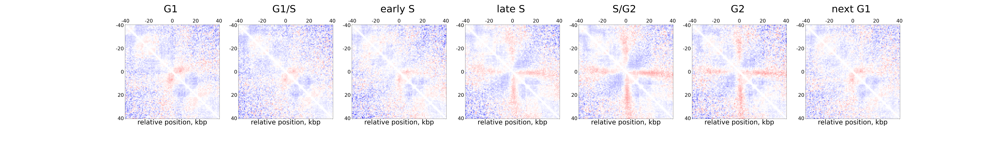

INFO:coolpuppy:('chrII', 'chrII'): 8
INFO:coolpuppy:('chrIII', 'chrIII'): 2
INFO:coolpuppy:('chrIV', 'chrIV'): 12
INFO:coolpuppy:('chrV', 'chrV'): 2
INFO:coolpuppy:('chrVI', 'chrVI'): 2
INFO:coolpuppy:('chrVII', 'chrVII'): 7
INFO:coolpuppy:('chrVIII', 'chrVIII'): 2
INFO:coolpuppy:('chrX', 'chrX'): 6
INFO:coolpuppy:('chrXI', 'chrXI'): 9
INFO:coolpuppy:('chrXII', 'chrXII'): 7
INFO:coolpuppy:('chrXIII', 'chrXIII'): 6
INFO:coolpuppy:('chrXIV', 'chrXIV'): 3
INFO:coolpuppy:('chrXV', 'chrXV'): 4
INFO:coolpuppy:('chrXVI', 'chrXVI'): 3
INFO:coolpuppy:Total number of piled up windows: 73
INFO:coolpuppy:('chrII', 'chrII'): 8
INFO:coolpuppy:('chrIII', 'chrIII'): 2
INFO:coolpuppy:('chrIV', 'chrIV'): 12
INFO:coolpuppy:('chrV', 'chrV'): 2
INFO:coolpuppy:('chrVI', 'chrVI'): 2
INFO:coolpuppy:('chrVII', 'chrVII'): 7
INFO:coolpuppy:('chrVIII', 'chrVIII'): 2
INFO:coolpuppy:('chrX', 'chrX'): 6
INFO:coolpuppy:('chrXI', 'chrXI'): 9
INFO:coolpuppy:('chrXII', 'chrXII'): 7
INFO:coolpuppy:('chrXIII', 'chrXIII'):

In [77]:
labels=["G1","G1/S","early S","late S","S/G2","G2","next G1"]

#Plot strongest early CARS outside centromeres (same statistic as early origins-107 sites)

dfs=[early_CAR]
exp_mtx=[]
for e in range(0,len(dfs)):
    expected_MicroC=[]

    n_groups=len(labels)
    fig, axs = plt.subplots(1, n_groups, figsize=(12*n_groups, 12))
    directory=["GSM4585143_23C-15min.mcool","GSM4585144_23C-30min.mcool","GSM4585145_23C-45min.mcool","GSM4585146_23C-60min.mcool","GSM4585147_23C-75min.mcool","GSM4585148_23C-90min.mcool","GSM4585149_23C-105min.mcool"]
    for dire in range(len(directory)):
        resolution=800
        flank=40_000
       
       
        sites_frame=dfs[e][(dfs[e]["cen_dist"]>flank)]
        sites_frame=sites_frame.sort_values("signal",ascending=False)[:75]

        
        clr = cooler.Cooler(dir_coolers+"/"+directory[dire]+"::/resolutions/"+str(resolution))
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        expected['s_bp'] = expected['dist']* resolution
        expected['count.sum'].loc[expected['dist'] < 2] = np.nan
        region="chrIV"
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        ax = axs[dire]
        ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)

## Ohno et al.- MicroC HU arrested

<IPython.core.display.Javascript object>


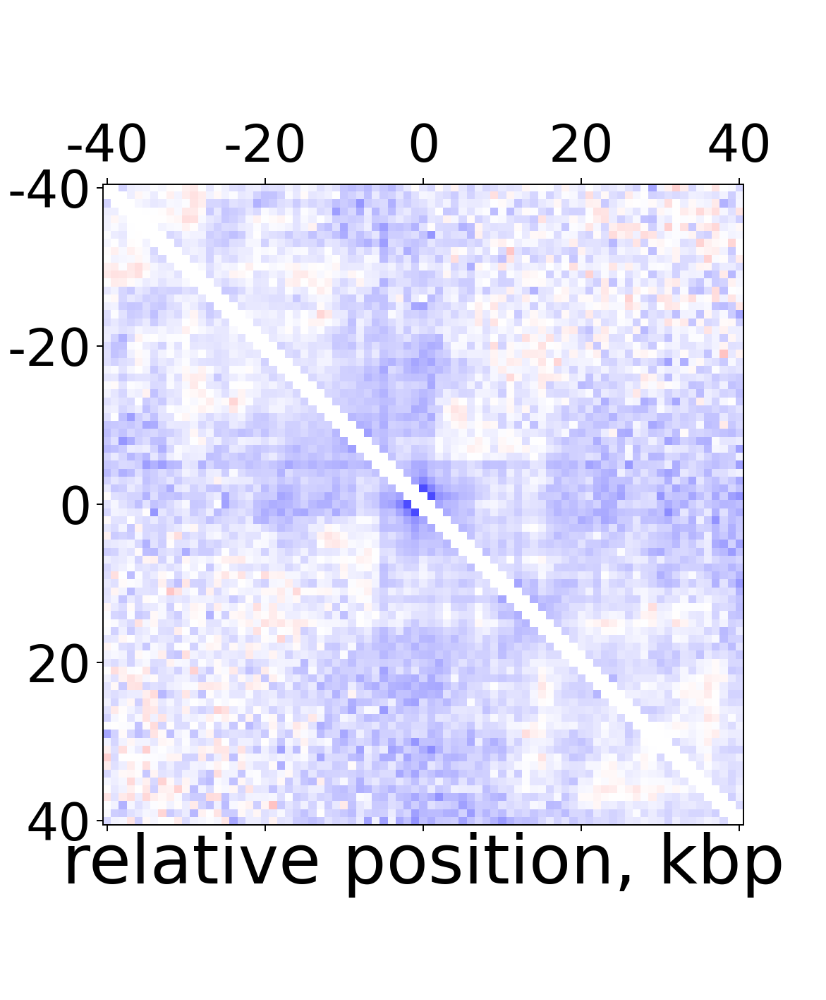

INFO:coolpuppy:('chrI', 'chrI'): 2
INFO:coolpuppy:('chrII', 'chrII'): 8
INFO:coolpuppy:('chrIII', 'chrIII'): 4
INFO:coolpuppy:('chrIV', 'chrIV'): 10
INFO:coolpuppy:('chrV', 'chrV'): 5
INFO:coolpuppy:('chrVI', 'chrVI'): 4
INFO:coolpuppy:('chrVII', 'chrVII'): 12
INFO:coolpuppy:('chrVIII', 'chrVIII'): 5
INFO:coolpuppy:('chrIX', 'chrIX'): 3
INFO:coolpuppy:('chrX', 'chrX'): 7
INFO:coolpuppy:('chrXI', 'chrXI'): 8
INFO:coolpuppy:('chrXII', 'chrXII'): 10
INFO:coolpuppy:('chrXIII', 'chrXIII'): 8
INFO:coolpuppy:('chrXIV', 'chrXIV'): 6
INFO:coolpuppy:('chrXV', 'chrXV'): 8
INFO:coolpuppy:('chrXVI', 'chrXVI'): 7
INFO:coolpuppy:Total number of piled up windows: 107


In [10]:
labels=[" S" ]

dfs=[all_sites[(all_sites["signal"]>5)]]

exp_mtx=[]
for e in range(len(dfs)):
    expected_MicroC=[]

    n_groups=len(labels)
    fig, ax = plt.subplots(1, n_groups, figsize=(12*n_groups, 12))
    directory=["ohno-S.sacCer3.mapq_30.1000.mcool"]
    for dire in range(len(directory)):
        resolution=1000
        flank=40_000
       
       
        #sites_frame=dfs[e][(dfs[e]["dist_tel"]>flank)*(dfs[e]["start"]>flank)]
        sites_frame=dfs[e]
        
        clr = cooler.Cooler(dir_coolers+"/"+directory[dire]+"::/resolutions/"+str(resolution))
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        expected['s_bp'] = expected['dist']* resolution
        expected['count.sum'].loc[expected['dist'] < 2] = np.nan
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        im=ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        #ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)

<IPython.core.display.Javascript object>


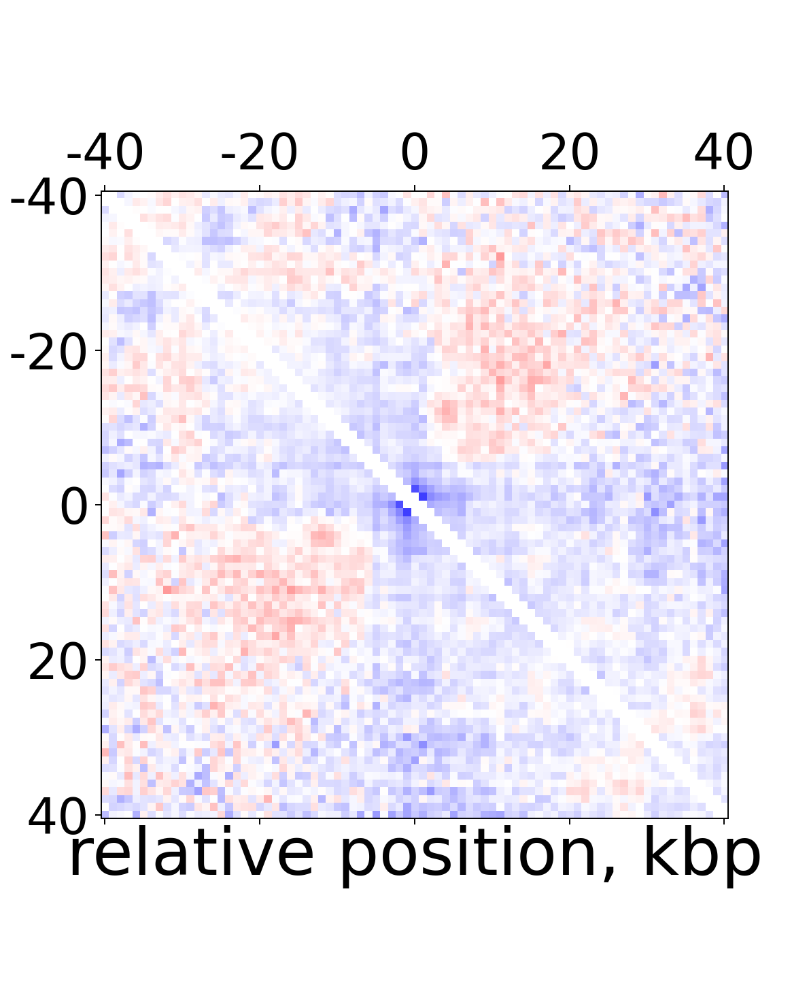

INFO:coolpuppy:('chrII', 'chrII'): 4
INFO:coolpuppy:('chrIII', 'chrIII'): 2
INFO:coolpuppy:('chrIV', 'chrIV'): 8
INFO:coolpuppy:('chrV', 'chrV'): 3
INFO:coolpuppy:('chrVI', 'chrVI'): 1
INFO:coolpuppy:('chrVII', 'chrVII'): 10
INFO:coolpuppy:('chrVIII', 'chrVIII'): 3
INFO:coolpuppy:('chrIX', 'chrIX'): 1
INFO:coolpuppy:('chrX', 'chrX'): 5
INFO:coolpuppy:('chrXI', 'chrXI'): 6
INFO:coolpuppy:('chrXII', 'chrXII'): 9
INFO:coolpuppy:('chrXIII', 'chrXIII'): 6
INFO:coolpuppy:('chrXIV', 'chrXIV'): 4
INFO:coolpuppy:('chrXV', 'chrXV'): 7
INFO:coolpuppy:('chrXVI', 'chrXVI'): 6
INFO:coolpuppy:Total number of piled up windows: 75


In [11]:
##Plot far from centromeres

labels=[" S" ]
dfs=[all_sites[(all_sites["signal"]>5)]]

exp_mtx=[]
for e in range(len(dfs)):
    expected_MicroC=[]

    n_groups=len(labels)
    fig, ax = plt.subplots(1, n_groups, figsize=(12*n_groups, 12))
    directory=["ohno-S.sacCer3.mapq_30.1000.mcool"]
    for dire in range(len(directory)):
        resolution=1000
        flank=40_000
       
       
        sites_frame=dfs[e][dfs[e]["dist_cen"]>flank]
        
        clr = cooler.Cooler(dir_coolers+"/"+directory[dire]+"::/resolutions/"+str(resolution))
        view_df=pd.DataFrame({"chrom":clr.chromnames,"start":0,"end":clr.chromsizes.values,"name":clr.chromnames})
        expected = cooltools.expected_cis(clr, view_df=view_df,clr_weight_name="weight", nproc=2, chunksize=1_000_000)
        expected['s_bp'] = expected['dist']* resolution
        expected['count.sum'].loc[expected['dist'] < 2] = np.nan
        pup = coolpup.pileup(clr, sites_frame,clr_weight_name="weight", features_format='bed', expected_df=expected, view_df=view_df,flank=flank ,local=True)
        
        mtx=pup.loc[0, 'data']
        im=ax.matshow(
            np.log2(mtx),
            vmax = 1,
            vmin = -1,
            cmap='bwr',
            interpolation='none')
        ticks_pixels = np.linspace(0, flank*2//resolution,5)
        ticks_kbp = ((ticks_pixels-ticks_pixels[-1]/2)*resolution//1000).astype(int)
        ax.set(
               xticks=ticks_pixels,
               xticklabels=ticks_kbp,
               yticks=ticks_pixels,
               yticklabels=ticks_kbp,
               xlabel='relative position, kbp')
        ax.xaxis.label.set_size(40)
        #ax.set_title(f'{labels[dire]} ',size=60,pad=40)
        ax.xaxis.set_tick_params(labelsize=30)
        ax.yaxis.set_tick_params(labelsize=30)

<IPython.core.display.Javascript object>


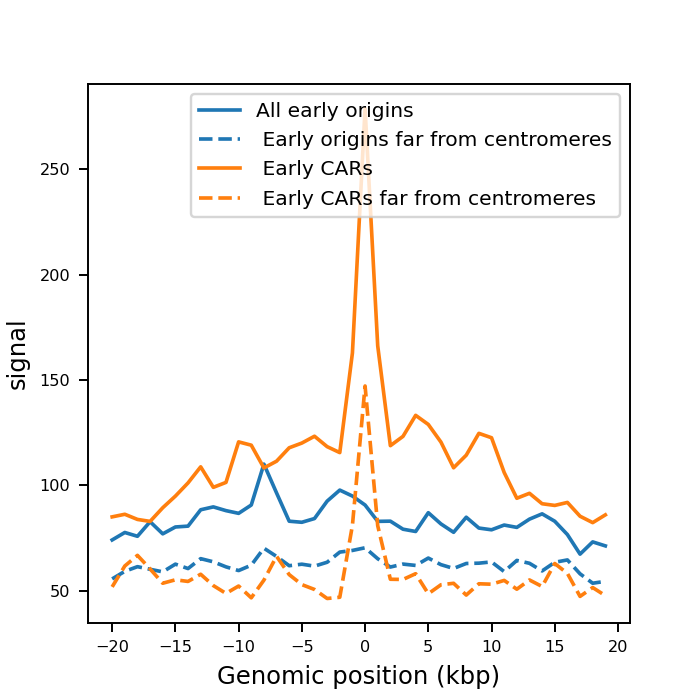

In [14]:
chip="GSM4577746_Mcd1p_45min_23.bigwig"
cmap = plt.get_cmap("tab10")
fig, ax = plt.subplots(1, 1, figsize=(12/resize, 12/resize))
chrom_dfs=[]
ARS_signal=[]
for chrom in clr.chromnames[:-1]:
    if(chrom!="chrXII"):
        df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"+"/"+chip, chrom)
        df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
        a1=[]
        for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
            a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
        chrom_ARS=all_sites[(all_sites["signal"]>5)*(all_sites["chrom"]==chrom)]
        a1=np.array(a1)
        
        for i in range(len(chrom_ARS)):
            start=int(chrom_ARS.iloc[i]["start"]/1000)  
            if((start-20)>0)*(start+20<len(a1)): 
                ARS_signal.append(a1[start-20:start+20])
ax.plot(np.arange(len(ARS_signal[0]))-20,np.nanmean(np.array(ARS_signal),axis=0),"-",label="All early origins")

chrom_dfs=[]
ARS_signal=[]
for chrom in clr.chromnames[:-1]:
    if(chrom!="chrXII"):
        df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"+"/"+chip, chrom)
        df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
        a1=[]
        for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
            a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
        chrom_ARS=all_sites[(all_sites["signal"]>5)*(all_sites["chrom"]==chrom)*(all_sites["dist_cen"]>40_000)]
        a1=np.array(a1)
        
        for i in range(len(chrom_ARS)):
            start=int(chrom_ARS.iloc[i]["start"]/1000)  
            if((start-20)>0)*(start+20<len(a1)): 
                ARS_signal.append(a1[start-20:start+20])
ax.plot(np.arange(len(ARS_signal[0]))-20,np.nanmean(np.array(ARS_signal),axis=0),"--",color=cmap(0),label=" Early origins far from centromeres")

chrom_dfs=[]
CARS_signal=[]
for chrom in clr.chromnames[:-1]:
    if(chrom!="chrXII"):
        df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"+"/"+chip, chrom)
        df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
        a1=[]
        for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
            a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
        top_CARs_exp=CARs_exp.sort_values("signal",ascending=False)[:107]
        chrom_CAR=top_CARs_exp[(top_CARs_exp["chrom"]==chrom)]
        a1=np.array(a1)
        
        for i in range(len(chrom_CAR)):
            start=int(chrom_CAR.iloc[i]["start"]/1000)
            if((start-20)>0)*(start+20<len(a1)):
                CARS_signal.append(a1[start-20:start+20])
ax.plot(np.arange(len(CARS_signal[0]))-20,np.nanmean(np.array(CARS_signal),axis=0),"-",color=cmap(1),label=" Early CARs")





chrom_dfs=[]
CARS_signal=[]
for chrom in clr.chromnames[:-1]:
    if(chrom!="chrXII"):
        df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"+"/"+chip, chrom)
        df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
        a1=[]
        for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
            a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
        top_CARs_exp=CARs_exp.sort_values("signal",ascending=False)[:75]
        chrom_CAR=top_CARs_exp[(top_CARs_exp["chrom"]==chrom)*(top_CARs_exp["cen_dist"]>40_000)]
        a1=np.array(a1)
        
        for i in range(len(chrom_CAR)):
            start=int(chrom_CAR.iloc[i]["start"]/1000)
            if((start-20)>0)*(start+20<len(a1)):
                CARS_signal.append(a1[start-20:start+20])
ax.plot(np.arange(len(CARS_signal[0]))-20,np.nanmean(np.array(CARS_signal),axis=0),"--",color=cmap(1),label=" Early CARs far from centromeres")


ax.set_xlabel('Genomic position (kbp)', fontsize=30/resize)
ax.set_ylabel('signal',size=30/resize)
ax.legend( prop={'size': 25/resize})
ax.xaxis.set_tick_params(labelsize=20/resize)
ax.yaxis.set_tick_params(labelsize=20/resize)



<IPython.core.display.Javascript object>


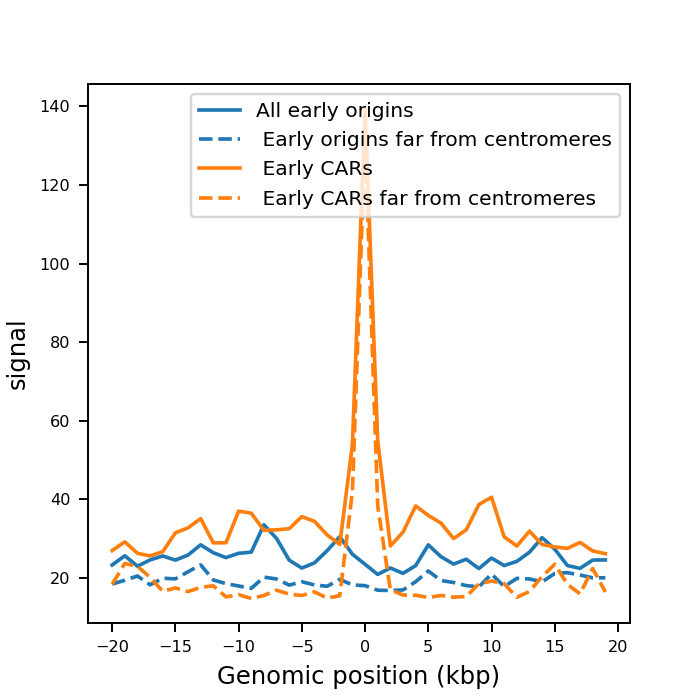

In [15]:
chip="GSE151416_RAW"+"/GSM4577764_Mcd1p_WT.bigwig"
cmap = plt.get_cmap("tab10")
fig, ax = plt.subplots(1, 1, figsize=(12/resize, 12/resize))
chrom_dfs=[]
ARS_signal=[]
for chrom in clr.chromnames[:-1]:
    if(chrom!="chrXII"):
        df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"+"/"+chip, chrom)
        df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
        a1=[]
        for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
            a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
        chrom_ARS=all_sites[(all_sites["signal"]>5)*(all_sites["chrom"]==chrom)]
        a1=np.array(a1)
        
        for i in range(len(chrom_ARS)):
            start=int(chrom_ARS.iloc[i]["start"]/1000)  
            if((start-20)>0)*(start+20<len(a1)): 
                ARS_signal.append(a1[start-20:start+20])
ax.plot(np.arange(len(ARS_signal[0]))-20,np.nanmean(np.array(ARS_signal),axis=0),"-",label="All early origins")

chrom_dfs=[]
ARS_signal=[]
for chrom in clr.chromnames[:-1]:
    if(chrom!="chrXII"):
        df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"+"/"+chip, chrom)
        df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
        a1=[]
        for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
            a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
        chrom_ARS=all_sites[(all_sites["signal"]>5)*(all_sites["chrom"]==chrom)*(all_sites["dist_cen"]>40_000)]
        a1=np.array(a1)
        
        for i in range(len(chrom_ARS)):
            start=int(chrom_ARS.iloc[i]["start"]/1000)  
            if((start-20)>0)*(start+20<len(a1)): 
                ARS_signal.append(a1[start-20:start+20])
ax.plot(np.arange(len(ARS_signal[0]))-20,np.nanmean(np.array(ARS_signal),axis=0),"--",color=cmap(0),label=" Early origins far from centromeres")

chrom_dfs=[]
CARS_signal=[]
for chrom in clr.chromnames[:-1]:
    if(chrom!="chrXII"):
        df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"+"/"+chip, chrom)
        df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
        a1=[]
        for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
            a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
        top_CARs_exp=CARs_exp.sort_values("signal",ascending=False)[:107]
        chrom_CAR=top_CARs_exp[(top_CARs_exp["chrom"]==chrom)]
        a1=np.array(a1)
        
        for i in range(len(chrom_CAR)):
            start=int(chrom_CAR.iloc[i]["start"]/1000)
            if((start-20)>0)*(start+20<len(a1)):
                CARS_signal.append(a1[start-20:start+20])
ax.plot(np.arange(len(CARS_signal[0]))-20,np.nanmean(np.array(CARS_signal),axis=0),"-",color=cmap(1),label=" Early CARs")





chrom_dfs=[]
CARS_signal=[]
for chrom in clr.chromnames[:-1]:
    if(chrom!="chrXII" ):
        df1 = bioframe.read_bigwig("/home/admindario/Desktop/backup_Settembre_22_di_ENS_folder/ENS/PhD_data/"+"/"+chip, chrom)
        df1["value_av"]=(df1["end"]-df1["start"])*df1["value"]
        a1=[]
        for i in range(1,int(int(round(clr.chromsizes[chrom]/1000)))):
            a1.append(np.mean(df1[(df1["start"]>(i-1)*1000)*(df1["start"]<i*1000)]["value_av"]))
        top_CARs_exp=CARs_exp.sort_values("signal",ascending=False)[:75]
        chrom_CAR=top_CARs_exp[(top_CARs_exp["chrom"]==chrom)*(top_CARs_exp["cen_dist"]>40_000)]
        a1=np.array(a1)
        
        for i in range(len(chrom_CAR)):
            start=int(chrom_CAR.iloc[i]["start"]/1000)
            if((start-20)>0)*(start+20<len(a1)):
                CARS_signal.append(a1[start-20:start+20])
ax.plot(np.arange(len(CARS_signal[0]))-20,np.nanmean(np.array(CARS_signal),axis=0),"--",color=cmap(1),label=" Early CARs far from centromeres")



ax.set_xlabel('Genomic position (kbp)', fontsize=30/resize)
ax.set_ylabel('signal',size=30/resize)
ax.legend( prop={'size': 25/resize},loc="upper right")
ax.xaxis.set_tick_params(labelsize=20/resize)
ax.yaxis.set_tick_params(labelsize=20/resize)

